Camera Calibration using OpenCV

In [ ]:
import cv2

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
import numpy as np 
import os
import glob
import matplotlib.pyplot as plt


In [ ]:
square_size = 2.88
img_mask = "/content/*.jpg"
pattern_size = (6, 8)

figsize = (20, 20)


In [ ]:
img_names = glob.glob(img_mask)
num_images = len(img_names)

pattern_points = np.zeros((np.prod(pattern_size), 3), np.float32)
pattern_points[:, :2] = np.indices(pattern_size).T.reshape(-1, 2)
pattern_points *= square_size

obj_points = []
img_points = []
h, w = cv2.imread(img_names[0]).shape[:2]

processing /content/20230124_184159.jpg... 
chessboard not found
processing /content/undist.jpg... 
/content/undist.jpg... OK
processing /content/20230124_184311.jpg... 
/content/20230124_184311.jpg... OK
processing /content/20230124_184152.jpg... 
chessboard not found
processing /content/20230124_184315.jpg... 
/content/20230124_184315.jpg... OK
processing /content/20230124_184252.jpg... 
/content/20230124_184252.jpg... OK
processing /content/20230124_184301.jpg... 
/content/20230124_184301.jpg... OK
processing /content/20230124_184202.jpg... 
chessboard not found
processing /content/20230124_184234.jpg... 
chessboard not found
processing /content/20230124_184328.jpg... 
/content/20230124_184328.jpg... OK
processing /content/20230124_184206.jpg... 
chessboard not found
processing /content/20230124_184220.jpg... 


AssertionError: ignored

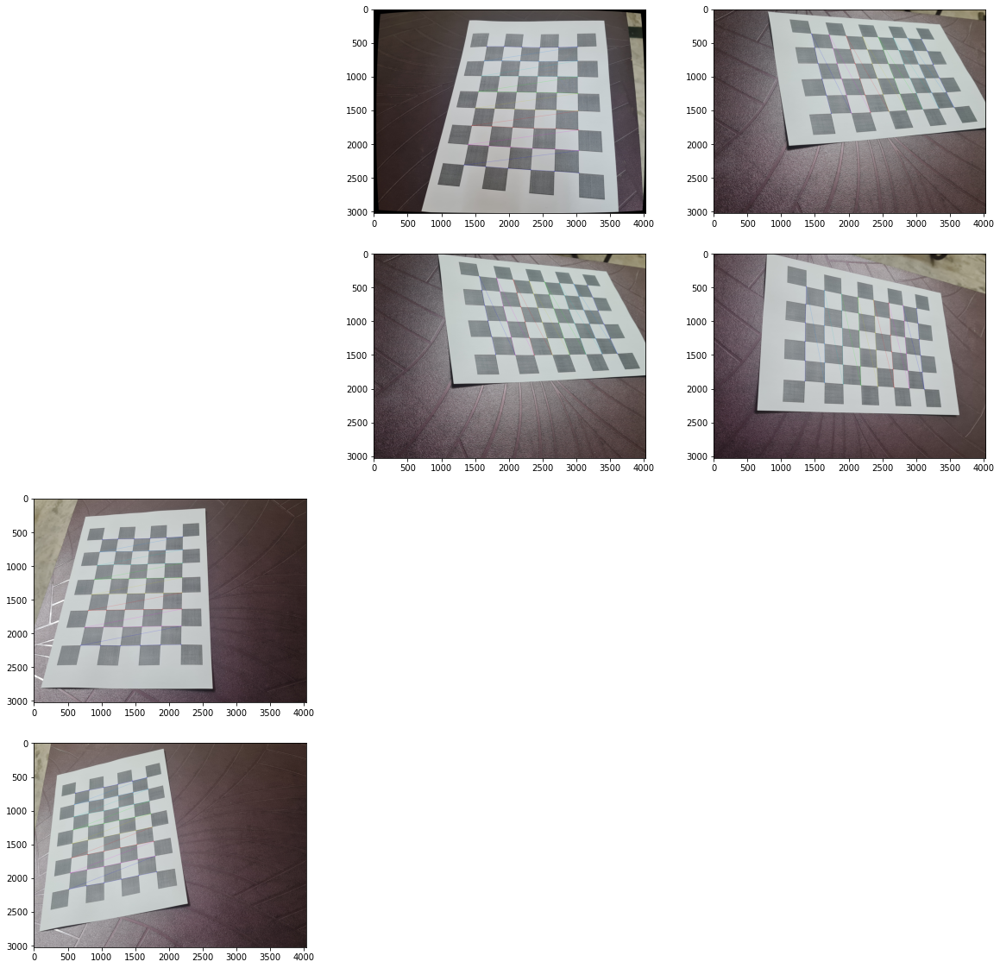

In [ ]:
plt.figure(figsize=figsize)

for i, fn in enumerate(img_names):
    print("processing %s... " % fn)
    imgBGR = cv2.imread(fn)

    if imgBGR is None:
        print("Failed to load", fn)
        continue

    imgRGB = cv2.cvtColor(imgBGR, cv2.COLOR_BGR2RGB)
    img = cv2.cvtColor(imgRGB, cv2.COLOR_RGB2GRAY)

    assert w == img.shape[1] and h == img.shape[0], f"size: {img.shape[1]} x {img.shape[0]}"
    found, corners = cv2.findChessboardCorners(img, pattern_size)
   

    if not found:
        print("chessboard not found")
        continue

    if i < 12:
        img_w_corners = cv2.drawChessboardCorners(imgRGB, pattern_size, corners, found)
        plt.subplot(4, 3, i + 1)
        plt.imshow(img_w_corners)

    print(f"{fn}... OK")
    img_points.append(corners.reshape(-1, 2))
    obj_points.append(pattern_points)


plt.show()

**Inference** : The Images Captured are displayed to further perform the calibration.

In [ ]:
import numpy as np
import cv2 as cv
import glob




chessboardSize = (6,8)
frameSize = (1440,1080)



criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)


objp = np.zeros((chessboardSize[0] * chessboardSize[1], 3), np.float32)
objp[:,:2] = np.mgrid[0:chessboardSize[0],0:chessboardSize[1]].T.reshape(-1,2)

size_of_chessboard_squares_mm = 20
objp = objp * size_of_chessboard_squares_mm


objpoints = []  
imgpoints = []  


images = glob.glob('/content/*.jpg')

for image in images:

    img = cv.imread(image)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    
    ret, corners = cv.findChessboardCorners(gray, chessboardSize, None)

    if ret == True:

        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray, corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)

        cv.drawChessboardCorners(img, chessboardSize, corners2, ret)
        cv.waitKey(1000)




In [ ]:
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

**Inference**: Using the opencv functions we have succesfully calibrated the Camera settings.

In [ ]:
import cv2

def save_coefficients(mtx, dist, path):
    cv_file = cv2.FileStorage(path, cv2.FILE_STORAGE_WRITE)
    cv_file.write('K', mtx)
    cv_file.write('D', dist)
    cv_file.release()

def load_coefficients(path):
    cv_file = cv2.FileStorage(path, cv2.FILE_STORAGE_READ)

    camera_matrix = cv_file.getNode('K').mat()
    dist_matrix = cv_file.getNode('D').mat()

    cv_file.release()
    return [camera_matrix, dist_matrix]

In [ ]:
save_coefficients(mtx, dist, "calibration_chessboard.yml")

**Inference**: We save the coefficients to perform undistortion of images

In [ ]:
mtx, dist = load_coefficients('calibration_chessboard.yml')
original = cv2.imread('/content/20230124_184234.jpg')
dst = cv2.undistort(original, mtx, dist, None, None)
cv2.imwrite('undist.jpg', dst)

True

Original Image with Distortion


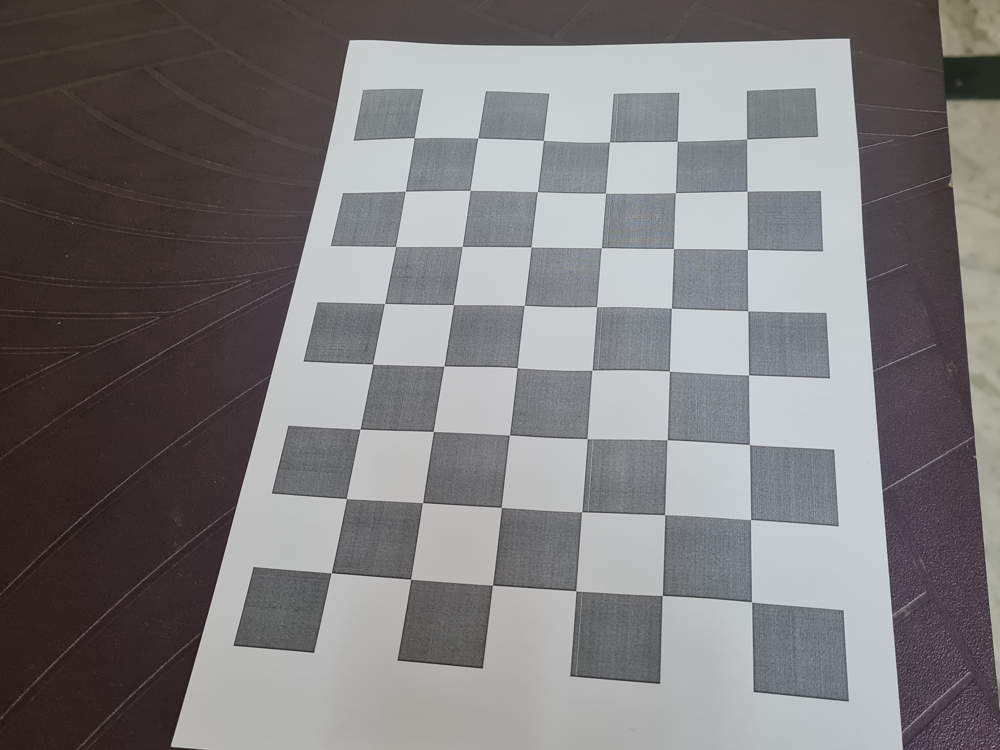

Undistorted Image


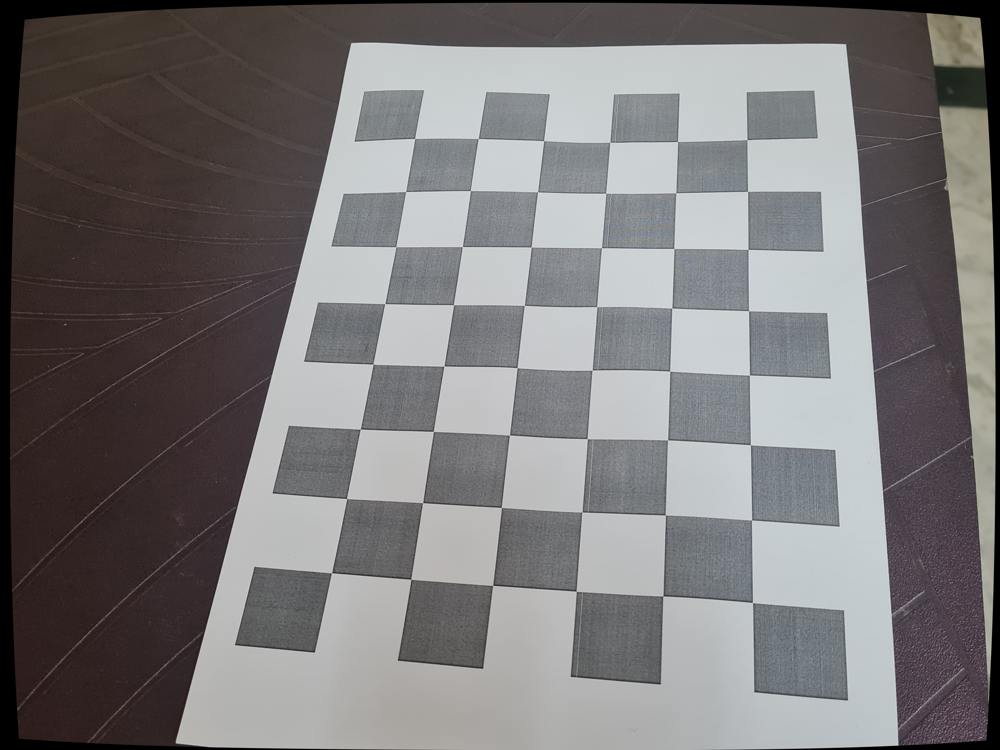

In [ ]:
from google.colab.patches import cv2_imshow
print('Original Image with Distortion')
cv2_imshow(original)
print('Undistorted Image')
cv2_imshow(dst)


**Inference**: By loading the coefficients we were able to undistort the images. The two images are displayed side by side for better comparison.

In [ ]:

mean_error = 0

for i in range(len(objpoints)):
    imgpoints2, _ = cv.projectPoints(objpoints[i], rvecs[i], tvecs[i], cameraMatrix, dist)
    error = cv.norm(imgpoints[i], imgpoints2, cv.NORM_L2)/len(imgpoints2)
    mean_error += error

print( "total error: {}".format(mean_error/len(objpoints)) )

total error: 0.011132854799740799


**Inference**": The total mean error is 0.011

In [ ]:
rms, camera_matrix, dist_coefs, _rvecs, _tvecs = cv2.calibrateCamera(obj_points, img_points, (w, h), None, None)

print("\nRMS:", rms)
print("camera matrix:\n", camera_matrix)
print("distortion coefficients: ", dist_coefs.ravel())


RMS: 3.7706716572199417
camera matrix:
 [[4.22669284e+03 0.00000000e+00 1.99572546e+03]
 [0.00000000e+00 4.31193886e+03 1.67269718e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]
distortion coefficients:  [ 8.36323073e-02 -5.51369459e-01  2.50084760e-04  1.55353262e-04
  2.81949733e+00]


**Inference**: The intrinsic coefficients to produce an undistorted image are displayed.

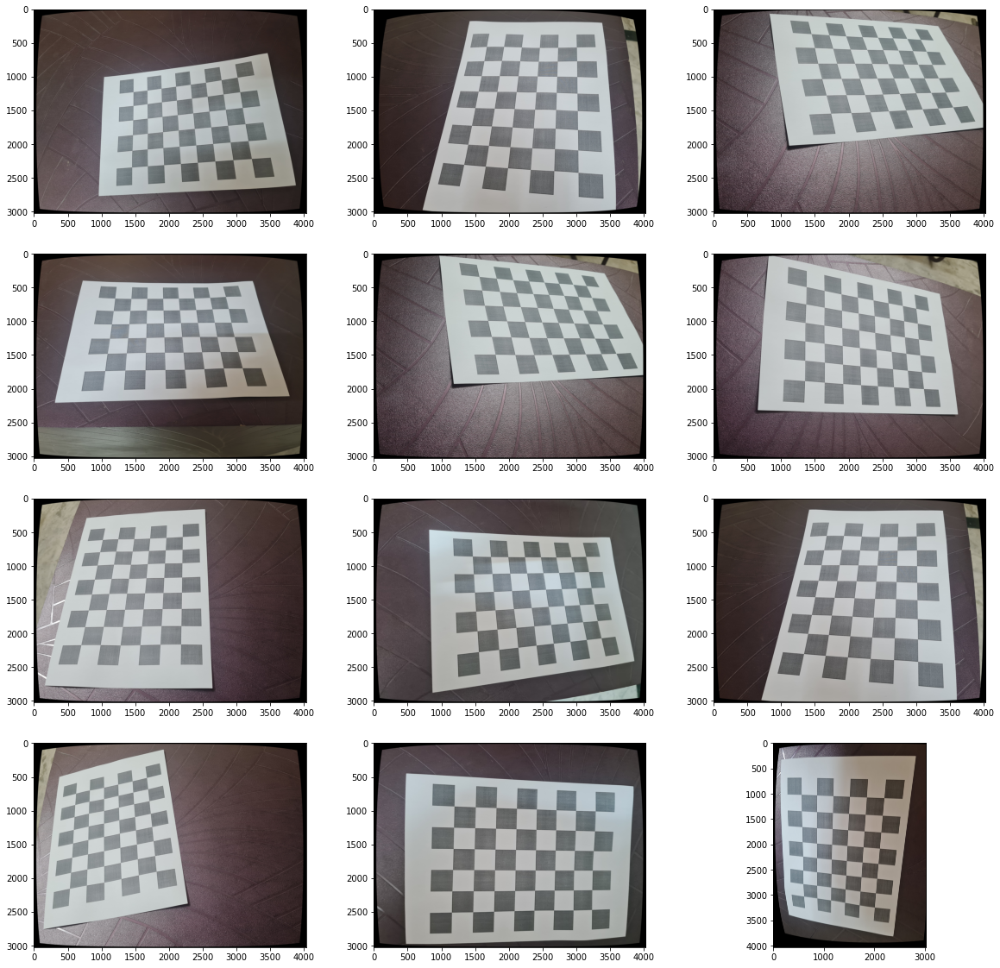

Done


In [ ]:
plt.figure(figsize=figsize)
for i, fn in enumerate(img_names):

    imgBGR = cv2.imread(fn)
    imgRGB = cv2.cvtColor(imgBGR, cv2.COLOR_BGR2RGB)

    dst = cv2.undistort(imgRGB, camera_matrix, dist_coefs)

    if i < 12:
        plt.subplot(4, 3, i + 1)
        plt.imshow(dst)

plt.show()
print("Done")

**Inference** : All the above images are undistorted

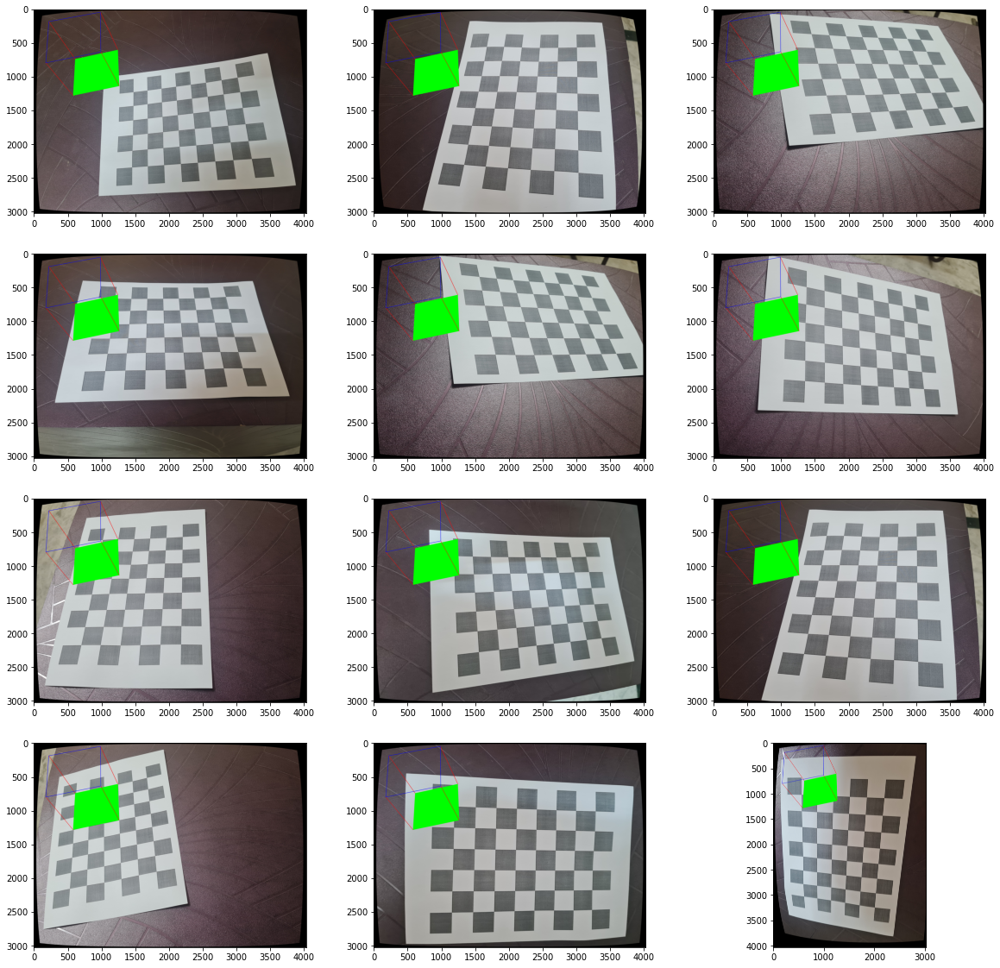

In [ ]:
objectPoints = (
    3
    * square_size
    * np.array([[0, 0, 0], [0, 1, 0], [1, 1, 0], [1, 0, 0], [0, 0, -1], [0, 1, -1], [1, 1, -1], [1, 0, -1]])
)


def draw(img, imgpts):
    imgpts = np.int32(imgpts).reshape(-1, 2)

    
    img = cv2.drawContours(img, [imgpts[:4]], -1, (0, 255, 0), -1)

    
    for i, j in zip(range(4), range(4, 8)):
        img = cv2.line(img, tuple(imgpts[i]), tuple(imgpts[j]), (255), 3)

    
    img = cv2.drawContours(img, [imgpts[4:]], -1, (0, 0, 255), 3)

    return img


plt.figure(figsize=figsize)
for i, fn in enumerate(img_names):

    imgBGR = cv2.imread(fn)
    imgRGB = cv2.cvtColor(imgBGR, cv2.COLOR_BGR2RGB)

    dst = cv2.undistort(imgRGB, camera_matrix, dist_coefs)

    # imgpts = cv2.projectPoints(objectPoints, _rvecs[i], _tvecs[i], camera_matrix, dist_coefs)[0]
    drawn_image = draw(dst, imgpts)

    if i < 12:
        plt.subplot(4, 3, i + 1)
        plt.imshow(drawn_image)

plt.show()

**Inference**: The above cubes are drawn on the chessboard to demonstrate the projection of 3D to 2D.

## Mathematics behind the calibration

A camera is a device that converts the 3D world into a 2D image. A camera plays a very important role in capturing three-dimensional images and storing them in two-dimensional images.

 To explain the mathematics, let us consider a Pinhole Camera model.

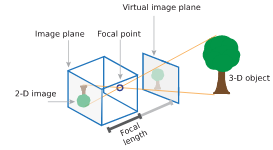

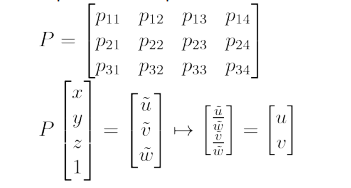

The pinhole camera parameters are represented in a 3-by-4 matrix called the camera matrix. This matrix maps the 3-D world scene into the image plane. 

The calibration algorithm calculates the camera matrix using the extrinsic and intrinsic parameters. The extrinsic parameters represent the location of the camera in the 3-D scene. The intrinsic parameters represent the optical center and focal length of the camera.

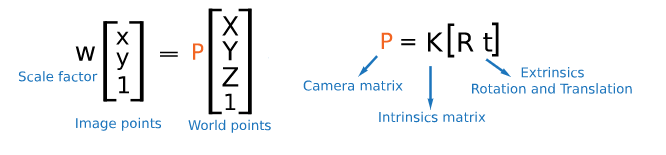

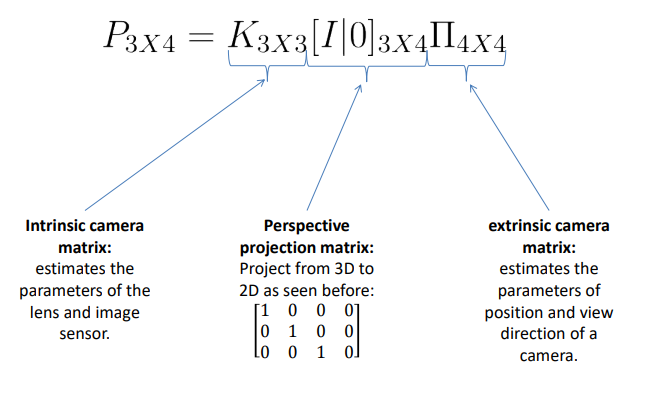

Intrinsic Camera Matrix:


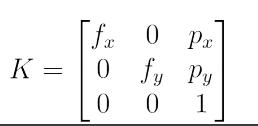




The Intrinsic Camera matrix contains 4 intrinsic parameters namely:

- Scaled x and y focal lengths

- Principal points (x and y)


## Alternative ways to calibrate the camera


### ArUco boards

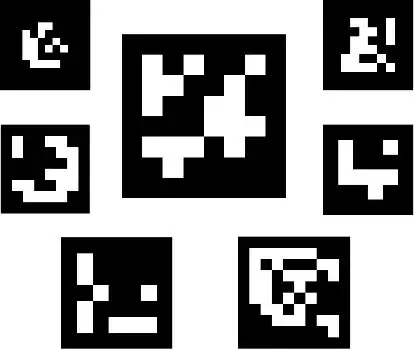

An ArUco marker is a synthetic square marker composed by a wide black border and an inner binary matrix which determines its identifiier.

 Calibrating the camera using ArUco is much more versatile than using traditional chessboard patterns, since you don’t need to include the complete board view.

### ChArUco boards

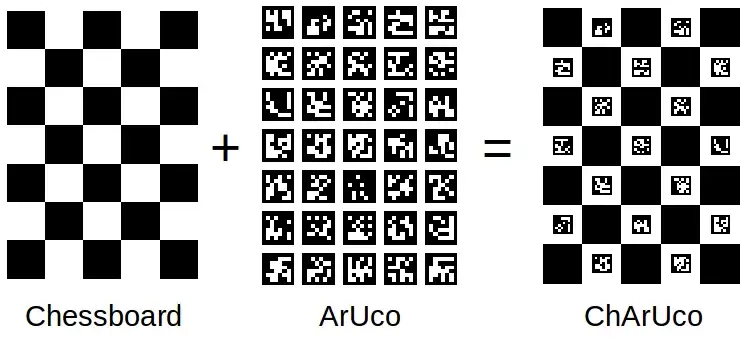

The ChArUco combines both Chessboard and the ArUco approaches.

ArUco markers and boards are very fast to detect.The detection of the corners of a chessboard can highly more accurate as each corner is surrounded by two black squares.

Hence ChArUco boards leverage both the approaches for a fast anda accurate camera calibration.

## Conclusion


Camera calibration is a fundamental step in many computer vision applications.

It will correct the distortions that a camera inserts into an image. If you need to know distances or orientation, it is a must-do process. 

To perform calibration, we captured images from multiple viewpoints. This increased the non-linearity of the constraints and helped the algorithm converge to the right results.

# Part 2 - Linked Lists

## Adding a New Node to the Linked List

In [ ]:
class Node:
  def __init__(self,value):
    self.data = value
    self.next = None

In [ ]:
class LinkedList:
  def __init__(self):
    self.head = None
    self.n = 0

  def __len__(self):
    return self.n

  def insert_head(self,value):
    new_node = Node(value)
    new_node.next = self.head
    self.head = new_node
    self.n += 1

  def __str__(self):
    curr  = self.head
    result = ''

    while curr !=None:
      result = result + str(curr.data) + '->'
      curr = curr.next
    return result[:-2]

  def append(self,value):
    new_node = Node(value)
    curr = self.head

    while curr.next != None:
      curr = curr.next
    curr.next = new_node


  def clear(self):
    self.head = None
    self.n = 0


  def delete_head(self):
    if self.head == None:
      return 'Empty Linked List'
    self.head = self.head.next
    self.n = self.n - 1


  def pop(self):
    if self.head == None:
      return "Empty Linked List"
    curr = self.head
    if curr.next == None:
      self.delete_head()
      return
    while curr.next.next != None:
      curr = curr.next
    curr.next = None
    self.n = self.n - 1


  def remove_by_value(self,value):
    if self.head == None:
      return "Empty Linked List"
    if self.head.data == value:
      return self.delete_head()
    curr = self.head
    while curr.next != None:
      if curr.next.data == value:
        break
      curr = curr.next
    if curr.next == None:
      return "Item not found"
    else:
      curr.next = curr.next.next


  def delete_all(self):
    while (self.head != None):
      curr = self.head
      self.head = self.head.next
      curr = None
    print("All nodes are deleted successfully.")  

  def display(self):
    curr = self.head
    while curr != None:
      print(curr.data, end = ' ')
      curr  = curr.next

  def remove_by_values(self,value):
    if self.head == None:
      return "Empty Linked List"
    if self.head.data == value:
      return self.delete_head()
    curr = self.head
    while curr.next != None:
      if curr.next.data == value:
        break
      curr = curr.next
    if curr.next == None:
      return "Item not found"
    else:
      curr.next = curr.next.next.next

In [ ]:
L = LinkedList()

In [ ]:
L.insert_head(2)
L.insert_head(5)
L.insert_head(8)
L.insert_head(10)
L.insert_head(19)
L.insert_head(99)
L.insert_head(100)
L.insert_head(101)

In [ ]:
print(L)

101->100->99->19->10->8->5->2


**Inference**: We have succesfully added new nodes to an empty Linked List

## Deleting a particular node (referenced by the location)

In [ ]:
print(L)

101->100->99->19->10->8->5->2


In [ ]:
L.delete_head()

In [ ]:
print(L)

100->99->19->10->8->5->2


In [ ]:
L.pop()

In [ ]:
print(L)

100->99->19->10->8->5


**Inference** : We have succesfully deleted the head and tail nodes

 



## Delete all the nodes from the list which contain a particular data say a number 5

In [ ]:
print(L)

101->100->99->19->10->8->5->2


In [ ]:
L.remove_by_value(5)
print(L)

101->100->99->19->10->8->2


**Inference** : We have succesfully deleted node with value = 5

## Delete the complete linked list 

In [ ]:
L.delete_all()

All nodes are deleted successfully.


In [ ]:
print(L)

**Inference** : We have succesfully deleted the complete linked list





## Display the linked list 

In [ ]:
L.display()

101 100 99 19 10 8 5 2 

**Inference** : We have succesfully displayed the complete linked list

## Display the Inverted Linked List

In [ ]:
class LinkedList:
    def __init__(self):
        self.head = None
        self.last_node = None
 
    def append(self, data):
        if self.last_node is None:
            self.head = Node(data)
            self.last_node = self.head
        else:
            self.last_node.next = Node(data)
            self.last_node = self.last_node.next
 
    def display(self):
        curr = self.head
        while curr:
            print(curr.data, end = ' ')
            curr = curr.next
 
 
def reverse_llist(llist):
    before = None
    curr = llist.head
    if curr is None:
        return
    after = curr.next
    while after:
        curr.next = before
        before = curr
        curr = after
        after = after.next
    curr.next = before
    llist.head = curr


a_llist = LinkedList()
 
data_list = input('Values of the linked list: ').split()
for data in data_list:
    a_llist.append(int(data))
 
reverse_llist(a_llist)
 
print('The reversed list: ')
a_llist.display()

Values of the linked list: 42 56 88 96 105 207
The reversed list: 
207 105 96 88 56 42 

**Inference** : We have succesfully displayed the inverted linked list

 



## Display the total memory space occupied by the linked list


In [ ]:
print(L)

101->100->99->19->10->8->5->2


In [ ]:
import sys
print(sys.getsizeof([])) # empty list
print(sys.getsizeof(L))  # Linked List

56
48


## Delete all the nodes from the list which contain a particular data say a number 5 and the next subsequent node

In [ ]:
L = LinkedList()

In [ ]:
L.insert_head(1)
L.insert_head(2)
L.insert_head(3)
L.insert_head(5)
L.insert_head(8)
L.insert_head(10)
L.insert_head(19)
L.insert_head(99)
L.insert_head(100)
L.insert_head(101)

In [ ]:
print(L)

101->100->99->19->10->8->5->3->2->1


In [ ]:
L.remove_by_values(5)

In [ ]:
print(L)

101->100->99->19->10->8->2->1


**Inference** : We have succesfully deleted all the nodes from the list which contain 5 and the next subsequent node
